# OPENAI GYM
## Assault
Sergio Abraham Botina Josa

OpenAI Gym is a powerful toolkit designed for developing and benchmarking reinforcement learning (RL) algorithms. It provides a standardized interface to interact with a wide variety of environments, ranging from simple control tasks to complex simulations, such as robotics, games, and physics-based systems. This versatility makes it a cornerstone for researchers and practitioners exploring the field of RL.

Reinforcement learning focuses on training agents to make decisions by interacting with an environment, aiming to maximize cumulative rewards over time. OpenAI Gym facilitates this by offering a diverse set of environments where agents can be trained and tested. The environments are structured around the Markov Decision Process (MDP) framework, which defines states, actions, rewards, and transitions. This setup simplifies the integration of RL algorithms, enabling users to focus on optimizing their models.

In the context of neural networks, OpenAI Gym plays a crucial role as it provides a platform to train deep reinforcement learning models, such as Deep Q-Networks (DQN), Proximal Policy Optimization (PPO), and Actor-Critic methods. Neural networks serve as function approximators in RL, learning to map complex input spaces (states) to actions or value functions.

This notebook will introduce key concepts of OpenAI Gym, demonstrate how to interact with its environments, and provide a foundation for implementing neural-network-based RL algorithms. The goal is to equip readers with the practical tools and knowledge to experiment with reinforcement learning in a hands-on manner.

In [1]:
#librerias necesarias
!sudo apt-get update
!sudo apt-get install -y xvfb ffmpeg freeglut3-dev
!pip install 'imageio==2.4.0'
!pip install pyvirtualdisplay
!pip install tf-agents[reverb]
!pip install pyglet
!pip install swig
!pip install gym[atari,box2d,accept-rom-license]  #install gym and virtual display

Get:1 https://packages.cloud.google.com/apt gcsfuse-focal InRelease [1227 B]
Get:2 https://packages.cloud.google.com/apt cloud-sdk InRelease [1618 B]
Get:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1581 B]
Hit:4 https://packages.cloud.google.com/apt google-fast-socket InRelease
Hit:5 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:6 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:7 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:8 https://packages.cloud.google.com/apt gcsfuse-focal/main amd64 Packages [29.3 kB]
Get:9 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [1196 kB]
Get:10 https://packages.cloud.google.com/apt cloud-sdk/main all Packages [1588 kB]
Get:11 https://packages.cloud.google.com/apt cloud-sdk/main amd64 Packages [3446 kB]
Get:12 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:13 http://security.ubuntu.com/ubuntu ja

In [2]:
!pip show tf-agents tensorflow

Name: tf-agents
Version: 0.19.0
Summary: TF-Agents: A Reinforcement Learning Library for TensorFlow
Home-page: https://github.com/tensorflow/agents
Author: Google LLC
Author-email: no-reply@google.com
License: Apache 2.0
Location: /opt/conda/lib/python3.10/site-packages
Requires: absl-py, cloudpickle, gin-config, gym, numpy, pillow, protobuf, pygame, six, tensorflow-probability, typing-extensions, wrapt
Required-by: 
---
Name: tensorflow
Version: 2.15.1
Summary: TensorFlow is an open source machine learning framework for everyone.
Home-page: https://www.tensorflow.org/
Author: Google Inc.
Author-email: packages@tensorflow.org
License: Apache 2.0
Location: /opt/conda/lib/python3.10/site-packages
Requires: absl-py, astunparse, flatbuffers, gast, google-pasta, grpcio, h5py, keras, libclang, ml-dtypes, numpy, opt-einsum, packaging, protobuf, setuptools, six, tensorboard, tensorflow-estimator, tensorflow-io-gcs-filesystem, termcolor, typing-extensions, wrapt
Required-by: explainable-ai-sdk,

In [3]:
# @title Librerias 

from __future__ import absolute_import, division, print_function

import base64
import imageio
import IPython
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import PIL.Image
import pyvirtualdisplay
import reverb

import tensorflow as tf

from tf_agents.agents.dqn import dqn_agent
from tf_agents.drivers import py_driver
from tf_agents.environments import suite_gym
from tf_agents.environments import tf_py_environment
from tf_agents.eval import metric_utils
from tf_agents.metrics import tf_metrics
from tf_agents.networks import sequential
from tf_agents.policies import py_tf_eager_policy
from tf_agents.policies import random_tf_policy
from tf_agents.replay_buffers import reverb_replay_buffer
from tf_agents.replay_buffers import reverb_utils
from tf_agents.trajectories import trajectory
from tf_agents.specs import tensor_spec
from tf_agents.utils import common

from tf_agents.environments import  suite_gym
from tf_agents.environments.atari_preprocessing import AtariPreprocessing
from tf_agents.environments.atari_wrappers import FrameStack4
import gym

# To get smooth animations
import matplotlib.animation as animation
matplotlib.rc('animation', html='jshtml')

2024-12-13 20:30:21.072479: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-13 20:30:21.072543: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-13 20:30:21.074283: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


## Introduction to Arcade Learning Environment (ALE)

The Arcade Learning Environment (ALE) is a versatile platform for research in reinforcement learning (RL) and artificial intelligence (AI). Built upon a collection of Atari 2600 games, ALE provides a challenging benchmark for evaluating and comparing the performance of RL algorithms. By offering a consistent interface and a wide variety of environments, ALE has become a standard in RL research, particularly in the development of deep reinforcement learning methods.

Atari games are especially well-suited for reinforcement learning because they present complex, high-dimensional input spaces (e.g., pixel-based observations) and require agents to learn strategies for maximizing long-term rewards. These games involve dynamic and diverse challenges, including planning, exploration, and delayed rewards, which are critical for testing the robustness of RL models.

ALE provides environments based on the Markov Decision Process (MDP) framework, where agents interact with the game environment by perceiving pixel-based observations (states), taking discrete actions, and receiving rewards. The toolkit supports various modes, including raw pixel observations, RAM state access, and frame-skipping to accelerate training.

In combination with neural networks, ALE has been instrumental in the success of Deep Q-Networks (DQN) and other deep RL algorithms. Neural networks are used to approximate policies and value functions, enabling agents to map raw pixel observations to optimal actions effectively.

This notebook will provide an overview of ALE, demonstrate how to configure and interact with Atari game environments, and explore its integration with neural-network-based RL approaches. By the end, you will have a foundation for using ALE as a testing ground for advanced RL algorithms.



## Tetris Load

Below, the ALE environment for Tetris is loaded in its latest version. For more information, refer to the documentation [Assault - ALE](https://ale.farama.org/environments/assault/)

In [4]:
#load Tetris-v5 environment 
env = suite_gym.load(environment_name="ALE/Assault-v5",max_episode_steps=2700, gym_env_wrappers=[AtariPreprocessing,FrameStack4])
env

A.L.E: Arcade Learning Environment (version 0.7.5+db37282)
[Powered by Stella]


In [5]:
env.gym

<FrameStack4<AtariPreprocessing<TimeLimit<OrderEnforcing<AtariEnv<ALE/Assault-v5>>>>>>

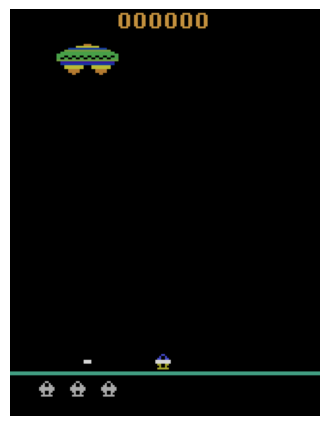

In [6]:
env.seed(42)
env.reset()
img = env.render(mode="rgb_array")
plt.figure(figsize=(4, 6))
plt.imshow(img)
plt.axis("off")
plt.show()

In [7]:
# Set up a virtual display for rendering OpenAI gym environments.
display = pyvirtualdisplay.Display(visible=0, size=(1400, 900)).start()

In [8]:
tf.version.VERSION

'2.15.1'

## Action and observation space

In [9]:
print('Avalible actions :\n{}\r\n'.format(env.gym.get_action_meanings()))
print('Obsevation space:\n{}'.format(env.observation_spec()))

Avalible actions :
['NOOP', 'FIRE', 'UP', 'RIGHT', 'LEFT', 'RIGHTFIRE', 'LEFTFIRE']

Obsevation space:
BoundedArraySpec(shape=(84, 84, 4), dtype=dtype('uint8'), name='observation', minimum=0, maximum=255)


## Wrappers Agents

In [10]:
#Aquí está la lista de wrappers disponibles:
import tf_agents.environments.wrappers

for name in dir(tf_agents.environments.wrappers):
    obj = getattr(tf_agents.environments.wrappers, name)
    if hasattr(obj, "__base__") and issubclass(obj, tf_agents.environments.wrappers.PyEnvironmentBaseWrapper):
        print("{:27s} {}".format(name, obj.__doc__.split("\n")[0]))

ActionClipWrapper           Wraps an environment and clips actions to spec before applying.
ActionDiscretizeWrapper     Wraps an environment with continuous actions and discretizes them.
ActionOffsetWrapper         Offsets actions to be zero-based.
ActionRepeat                Repeates actions over n-steps while acummulating the received reward.
ExtraDisabledActionsWrapper Adds extra unavailable actions.
FixedLength                 Truncates long episodes and pads short episodes to have a fixed length.
FlattenActionWrapper        Flattens the action.
FlattenObservationsWrapper  Wraps an environment and flattens nested multi-dimensional observations.
GoalReplayEnvWrapper        Adds a goal to the observation, used for HER (Hindsight Experience Replay).
HistoryWrapper              Adds observation and action history to the environment's observations.
ObservationFilterWrapper    Filters observations based on an array of indexes.
OneHotActionWrapper         Converts discrete action to one_h

## Define the actions 

(84, 84, 4)


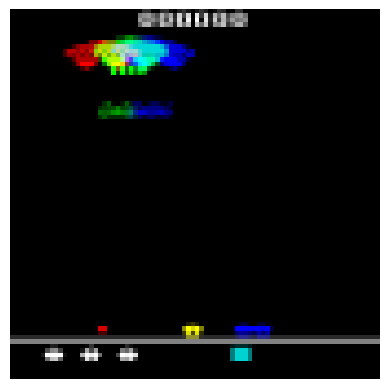

In [11]:
#Algunos ejemplos de acciones en el juego
env.reset()
time_step = env.step(np.array(0)) # NOOP
time_step = env.step(np.array(3)) # LEFT
time_step = env.step(np.array(4)) # DOWN

observation = time_step.observation.astype(np.float32)

#Como existen 3 canales de colores, no podemos mostrar 4 frames.
image = observation[..., :3]
image = np.clip(image / 150, 0, 1)
plt.imshow(image)
plt.axis("off")
print(observation.shape)

In [12]:
from tf_agents.environments.tf_py_environment import TFPyEnvironment
tf_env = TFPyEnvironment(env)

# Neuronal network for Agents

## DQN

In [13]:
from tf_agents.networks.q_network import QNetwork
#convertir observacinoes a float float 32, normalizando.. (valores  0.0 a 1.0) 
preprocessing_layer = tf.keras.layers.Lambda( lambda obs: tf.cast(obs, np.float32) / 255.)

# Arquitectura de la red
conv_layer_params = [
    (32, (8, 8), 4),  # Primera capa convolucional
    (64, (4, 4), 2),  # Segunda capa convolucional
    (128, (3, 3), 1)  # Tercera capa convolucional
]
fc_layer_params = (512, 256)  # Capas densas con 512 y 256 unidades


q_network = QNetwork(tf_env.observation_spec(), tf_env.action_spec()
                     ,preprocessing_layers=preprocessing_layer
                     ,conv_layer_params=conv_layer_params
                     ,fc_layer_params=fc_layer_params
                     ,activation_fn=tf.keras.activations.relu)

q_network.summary

<bound method Network.summary of <tf_agents.networks.q_network.QNetwork object at 0x795ba0d9c430>>

In [14]:
from tensorflow.keras.utils import plot_model

# Modelo en keras SOLO PARA GRAFICAR LA ESTRUCTURA
# Define las especificaciones del entorno desde tf_env
action_spec = tf_env.action_spec()
observation_spec = tf_env.observation_spec()

# Define el tamaño de las observaciones (supone que es una imagen o matriz)
input_shape = observation_spec.shape  # Ejemplo: (84, 84, 3)
keras_model = tf.keras.Sequential([
    preprocessing_layer,
    tf.keras.layers.Conv2D(32, (8, 8), strides=4, activation="relu"),
    tf.keras.layers.Conv2D(64, (4, 4), strides=2, activation="relu"),
    tf.keras.layers.Conv2D(128, (3, 3), strides=1, activation="relu"),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(512, activation="relu"),
    tf.keras.layers.Dense(256, activation="relu"),
    tf.keras.layers.Dense(action_spec.maximum + 1)  # Número de acciones
])

# Construir explícitamente el modelo con el tamaño de entrada
keras_model.build(input_shape=(None,) + input_shape)  # None para el batch size
# Visualizar y guardar el modelo
plot_model(
    keras_model,
    to_file="q_network_architecture.png",
    show_shapes=True,
    show_layer_names=True
)

print("¡Modelo visualizado y guardado como 'q_network_architecture.png'!")


¡Modelo visualizado y guardado como 'q_network_architecture.png'!


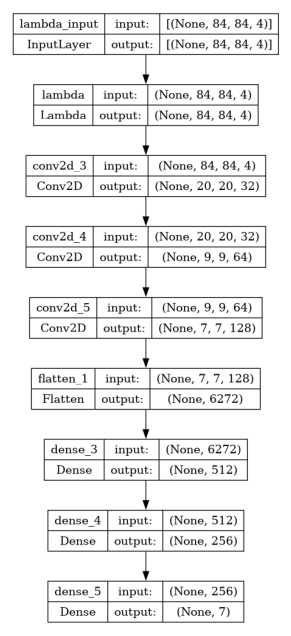

In [15]:
# Importar las bibliotecas necesarias
from PIL import Image

# Cargar la imagen
image_path = 'q_network_architecture.png'
img = Image.open(image_path)

# Mostrar la imagen
plt.figure(figsize=(11,8))
plt.imshow(img)
plt.axis('off')  # Ocultar los ejes
plt.show()

## DQN Agent

In [16]:
from tf_agents.agents.dqn.dqn_agent import DqnAgent

train_step = tf.Variable(0)
update_period = 4 
optimizer = tf.keras.optimizers.Adam(lr=2.5e-4, ema_momentum=0.1,epsilon=0.00001)
epsilon_fn = tf.keras.optimizers.schedules.PolynomialDecay(
    initial_learning_rate=0.8,
    decay_steps=250000 // update_period, 
    end_learning_rate=0.01)

agent = DqnAgent(tf_env.time_step_spec(),
                 tf_env.action_spec(),
                 q_network=q_network,
                 optimizer=optimizer,
                 target_update_period=2000, 
                 #La función de pérdida debe devolver un error por instancia, por lo que definimos reducción="none" 
                 td_errors_loss_fn=tf.keras.losses.Huber(reduction="none"),
                 gamma=0.89, # discount factor
                 train_step_counter=train_step,
                 epsilon_greedy=lambda: epsilon_fn(train_step))
agent.initialize()

# Buffer

In [17]:
from tf_agents.replay_buffers import tf_uniform_replay_buffer

#data_spec datos que se guardarán en el búfer.
#batch_size es el número de trayectorias que se deben agregar a cada paso.
#max_length es la longitud máxima de reproducción. (Documento DQN2015: Cuidado con el acaparador de RAM)

replay_buffer = tf_uniform_replay_buffer.TFUniformReplayBuffer( data_spec=agent.collect_data_spec,    batch_size=tf_env.batch_size, max_length=300000)#ojo para el entrenamiento

replay_buffer_observer = replay_buffer.add_batch

# Metrics

In [18]:
from tf_agents.metrics import tf_metrics
from tf_agents.eval.metric_utils import log_metrics
import logging

train_metrics = [
    tf_metrics.NumberOfEpisodes(),
    tf_metrics.EnvironmentSteps(),
    tf_metrics.AverageReturnMetric(),
    tf_metrics.AverageEpisodeLengthMetric(),
]
logging.getLogger().setLevel(logging.INFO)
log_metrics(train_metrics)

# Collect Driver

In [19]:
from tf_agents.drivers.dynamic_step_driver import DynamicStepDriver

collect_driver = DynamicStepDriver(
    tf_env,
    agent.collect_policy,
    observers=[replay_buffer_observer] + train_metrics,
    num_steps=update_period) 
collect_driver

In [20]:
from tf_agents.policies.random_tf_policy import RandomTFPolicy

class ShowProgress:
    def __init__(self, total):
        self.counter = 0
        self.total = total
    def __call__(self, trajectory):
        if not trajectory.is_boundary():
            self.counter += 1
        if self.counter % 100 == 0:
            print("\r{}/{}".format(self.counter, self.total), end="")

initial_collect_policy = RandomTFPolicy(tf_env.time_step_spec(),
                                        tf_env.action_spec())
init_driver = DynamicStepDriver(
    tf_env,
    initial_collect_policy,
    observers=[replay_buffer.add_batch, ShowProgress(20000)],
    num_steps=20000)
final_time_step, final_policy_state = init_driver.run()

20000/20000

In [21]:
#Ejemplo de la trayectoria final de un episodio
trajectories, buffer_info = replay_buffer.get_next(sample_batch_size=2, num_steps=17)
trajectories, buffer_info, trajectories._fields

(Trajectory(
 {'step_type': <tf.Tensor: shape=(2, 17), dtype=int32, numpy=
 array([[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
        [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]], dtype=int32)>,
  'observation': <tf.Tensor: shape=(2, 17, 84, 84, 4), dtype=uint8, numpy=
 array([[[[[0, 0, 0, 0],
           [0, 0, 0, 0],
           [0, 0, 0, 0],
           ...,
           [0, 0, 0, 0],
           [0, 0, 0, 0],
           [0, 0, 0, 0]],
 
          [[0, 0, 0, 0],
           [0, 0, 0, 0],
           [0, 0, 0, 0],
           ...,
           [0, 0, 0, 0],
           [0, 0, 0, 0],
           [0, 0, 0, 0]],
 
          [[0, 0, 0, 0],
           [0, 0, 0, 0],
           [0, 0, 0, 0],
           ...,
           [0, 0, 0, 0],
           [0, 0, 0, 0],
           [0, 0, 0, 0]],
 
          ...,
 
          [[0, 0, 0, 0],
           [0, 0, 0, 0],
           [0, 0, 0, 0],
           ...,
           [0, 0, 0, 0],
           [0, 0, 0, 0],
           [0, 0, 0, 0]],
 
          [[0, 0, 0

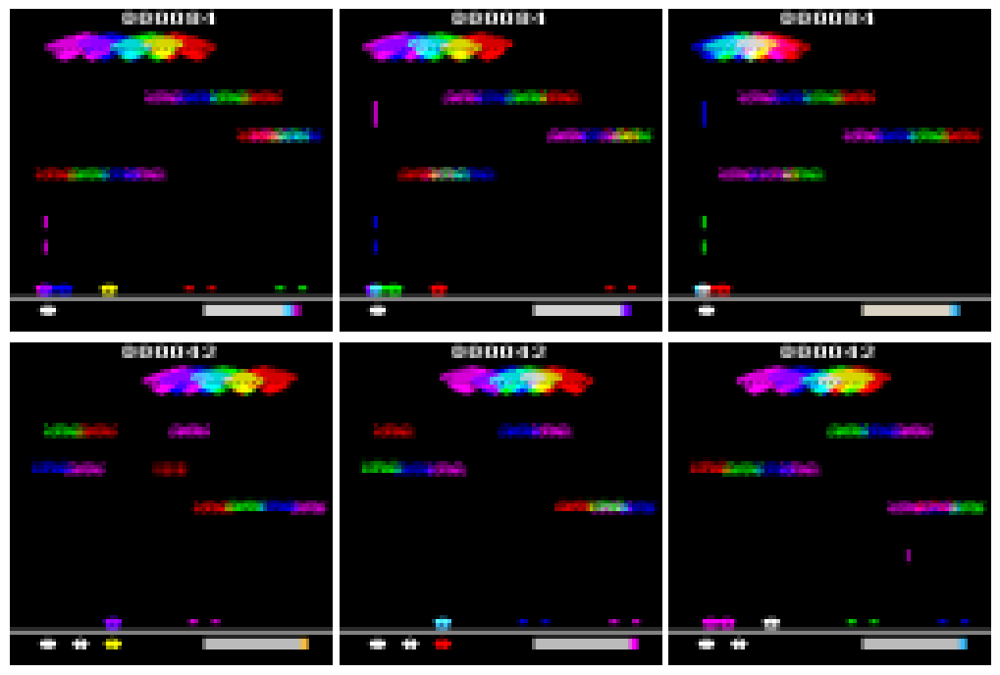

In [22]:
from tf_agents.trajectories.trajectory import to_transition

time_steps, action_steps, next_time_steps = to_transition(trajectories)
time_steps.observation.shape,trajectories.step_type.numpy()


plt.figure(figsize=(10, 6.8))
for row in range(2):
    for col in range(3):
        plt.subplot(2, 3, row * 3 + col + 1)
        obs = trajectories.observation[row, col].numpy().astype(np.float32)
        img = obs[..., :3]
        current_frame_delta = np.maximum(obs[..., 3] - obs[..., :3].mean(axis=-1), 0.)
        img[..., 0] += current_frame_delta
        img[..., 2] += current_frame_delta
        img = np.clip(img / 150, 0, 1)
        plt.imshow(img)
        plt.axis("off")
plt.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0, wspace=0.02)
plt.show()

# Dataset

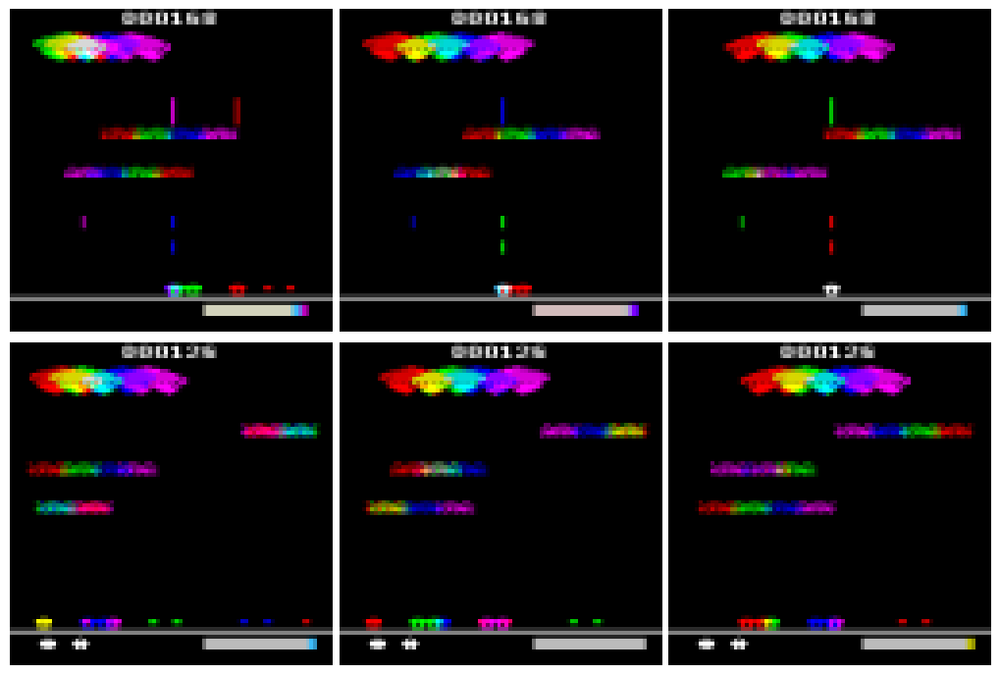

In [23]:
dataset = replay_buffer.as_dataset(
    sample_batch_size=64,
    num_steps=17,
    num_parallel_calls=3
).prefetch(3)
iterator = iter(dataset)
trajectories, buffer_info = next(iterator)
plt.figure(figsize=(10, 6.8))
for row in range(2):
    for col in range(3):
        plt.subplot(2, 3, row * 3 + col + 1)
        obs = trajectories.observation[row, col].numpy().astype(np.float32)
        img = obs[..., :3]
        current_frame_delta = np.maximum(obs[..., 3] - obs[..., :3].mean(axis=-1), 0.)
        img[..., 0] += current_frame_delta
        img[..., 2] += current_frame_delta
        img = np.clip(img / 150, 0, 1)
        plt.imshow(img)
        plt.axis("off")
plt.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0, wspace=0.02)
plt.show()


In [24]:
dataset = replay_buffer.as_dataset(
    sample_batch_size=64,
    num_steps=2,
    num_parallel_calls=3).prefetch(3)

# Training Loop

In [25]:
train_loss_results = []
average_return_results = []
average_episode_length_results = []

def train_agent(n_iterations):
    time_step = None
    policy_state = agent.collect_policy.get_initial_state(tf_env.batch_size)
    iterator = iter(dataset)

    for iteration in range(n_iterations):
        time_step, policy_state = collect_driver.run(time_step, policy_state)
        trajectories, buffer_info = next(iterator)
        train_loss = agent.train(trajectories)

        # Store the training loss at each iteration
        train_loss_results.append(train_loss.loss.numpy())

        # Store the average return and episode length metrics
        average_return_results.append(train_metrics[2].result().numpy())
        average_episode_length_results.append(train_metrics[3].result().numpy())

        print("\r{} loss: {:.5f}, avg return: {:.5f}, avg episode length: {:.5f}".format(
            iteration, train_loss.loss.numpy(), average_return_results[-1], average_episode_length_results[-1]), end="")

        if iteration % 1000 == 0:
            log_metrics(train_metrics)

n_iterations = 90000  # Adjust the number of iterations as needed
train_agent(n_iterations)

I0000 00:00:1734122051.717565      23 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


89999 loss: 3.45528, avg return: 392.70001, avg episode length: 153.89999

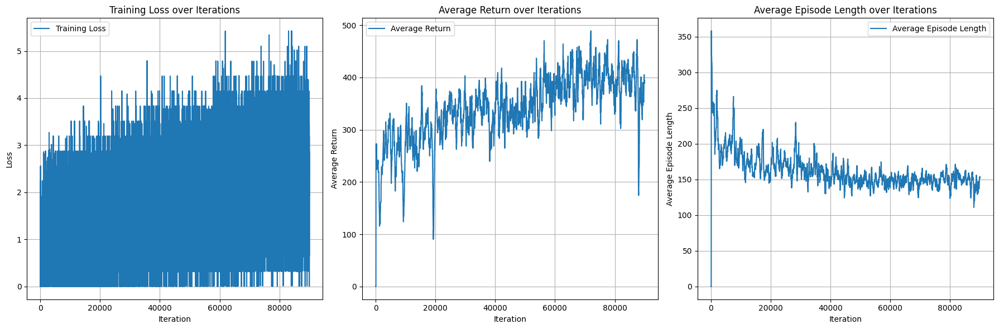

In [26]:
iterations = np.arange(n_iterations)

plt.figure(figsize=(18, 6))

# Loss plot
plt.subplot(1, 3, 1)
plt.plot(iterations, train_loss_results, label='Training Loss')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.title('Training Loss over Iterations')
plt.grid(True)
plt.legend()

# Average Return plot
plt.subplot(1, 3, 2)
plt.plot(iterations, average_return_results, label='Average Return')
plt.xlabel('Iteration')
plt.ylabel('Average Return')
plt.title('Average Return over Iterations')
plt.grid(True)
plt.legend()

# Average Episode Length plot
plt.subplot(1, 3, 3)
plt.plot(iterations, average_episode_length_results, label='Average Episode Length')
plt.xlabel('Iteration')
plt.ylabel('Average Episode Length')
plt.title('Average Episode Length over Iterations')
plt.grid(True)
plt.legend()

plt.tight_layout()

# Save the figure as an image file
plt.savefig("training_metrics.png", dpi=300, bbox_inches='tight')  # Save as PNG with high quality

plt.show()

# Visualization

In [27]:
def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch

def plot_animation(frames, repeat=False, interval=40):
    fig = plt.figure()
    patch = plt.imshow(frames[0])
    plt.axis('off')
    anim = animation.FuncAnimation(
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat=repeat, interval=interval)
    plt.close()
    return anim

In [28]:
frames = []
def save_frames(trajectory):
    global frames
    frames.append(tf_env.pyenv.envs[0].render(mode="rgb_array"))

prev_lives = tf_env.pyenv.envs[0].ale.lives()
def reset_and_fire_on_life_lost(trajectory):
    global prev_lives
    lives = tf_env.pyenv.envs[0].ale.lives()
    if prev_lives != lives:
        tf_env.reset()
        tf_env.pyenv.envs[0].step(np.array(tf_env.pyenv.envs[0].action_space.sample()))
        prev_lives = lives

watch_driver = DynamicStepDriver(
    tf_env,
    agent.policy,
    observers=[save_frames, reset_and_fire_on_life_lost, ShowProgress(10000)],
    num_steps=10000)
final_time_step, final_policy_state = watch_driver.run()

plot_animation(frames)

10000/10000

In [29]:
#Creando un gif
import PIL
import os

image_path = os.path.join("view1.gif")
frame_images = [PIL.Image.fromarray(frame) for frame in frames[:150]]
frame_images[0].save(image_path, format='GIF',
                     append_images=frame_images[1:],
                     save_all=True,
                     duration=300,
                     loop=0)

In [30]:
%%html
<img src="view9e5.gif" />